<a href="https://colab.research.google.com/github/MahmoudElkarargy/Image-Segmentation/blob/main/Image_Segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Image Segmentation.
- Image segmentation means that we can group similar pixels together and give these grouped pixels the same label.
- useing of K-means on the Berkeley Segmentation Benchmark.


---



In [ ]:
# Needed libraries.
import numpy as np
import sklearn
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import scipy.io
import os
import glob
import cv2
import matplotlib.image as mpimg
import scipy.io as sio
from sklearn.cluster import KMeans
from sklearn.cluster import SpectralClustering
from PIL import Image
from sklearn.metrics.cluster import contingency_matrix
import sklearn.metrics as metrics
from sklearn.cluster import KMeans
from scipy.spatial import distance_matrix
from sklearn.neighbors import kneighbors_graph

## PART 1 :: Download the Dataset and Understand the Format

In [ ]:
# The dataset has 50 images and 50 GroundTruth images.
! unzip BSR.zip

Archive:  BSR.zip
replace BSR/BSDS500/data/groundTruth/1/10081.mat? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: BSR/BSDS500/data/groundTruth/1/10081.mat  
replace BSR/BSDS500/data/groundTruth/1/14085.mat? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: BSR/BSDS500/data/groundTruth/1/14085.mat  
  inflating: BSR/BSDS500/data/groundTruth/1/14092.mat  
  inflating: BSR/BSDS500/data/groundTruth/1/15011.mat  
  inflating: BSR/BSDS500/data/groundTruth/1/15062.mat  
  inflating: BSR/BSDS500/data/groundTruth/1/16004.mat  
  inflating: BSR/BSDS500/data/groundTruth/1/16068.mat  
  inflating: BSR/BSDS500/data/groundTruth/1/17067.mat  
  inflating: BSR/BSDS500/data/groundTruth/1/20069.mat  
  inflating: BSR/BSDS500/data/groundTruth/1/2018.mat  
  inflating: BSR/BSDS500/data/groundTruth/1/23050.mat  
  inflating: BSR/BSDS500/data/groundTruth/1/28083.mat  
  inflating: BSR/BSDS500/data/groundTruth/1/29030.mat  
  inflating: BSR/BSDS500/data/groundTruth/1/3063.mat  
  inflating: BSR/BSD



---



---



In [ ]:
# 1. Download the Dataset and Understand the Format

# the 50 images folder bath
orginalImagesRoot = 'BSR/BSDS500/data/images/1/' 
# the 50 ground truth folder bath
groundTruthRoot = 'BSR/BSDS500/data/groundTruth/1/'
# images Lists..
orginalTestImgs = []
groundTruthImgs = []
groundTruthContor = []
testImgs = []
totalfmeasures=np.zeros((50,5))
totalentropy=np.zeros((50,5))

idx = 0
for img in glob.glob(f'{orginalImagesRoot}/*.jpg'):
  
  testImg = cv2.imread(img)
  # To load an image in grayscale mode.
  testImg = cv2.cvtColor(testImg, cv2.COLOR_BGR2RGB)
  orginalTestImgs.append(testImg)
  # Get the truth ground name of the img
  groundTruthName = os.path.splitext(os.path.basename(img))[0]
  idx += 1
  # read the truth ground img
  groundTruthImg = sio.loadmat(f'{groundTruthRoot}{groundTruthName}')
  for idx in range(0,5):
    groundTruthImgs.append(groundTruthImg['groundTruth'][0][idx][0][0][0])
    groundTruthContor.append(groundTruthImg['groundTruth'][0][idx][0][0][1])

# Convert ground images and orginal imgs from list to np array
groundTruthImgs = np.array(groundTruthImgs)
groundTruthContor = np.array(groundTruthContor)
orginalTestImgs = np.array(orginalTestImgs)

# Looping through the 50 imgs and reshape them
for idx in range(0,50):
  # Reshape it's dimentions to width*heights, 3 (R,G,B).
  img = orginalTestImgs[idx].reshape((-1,3))
  img = np.float32(img)
  # Append the reshabed imgs.
  testImgs.append(img)

testImgs = np.array(testImgs)
print(testImgs.shape)

(50, 154401, 3)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:32: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:33: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:34: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray




---


---



## PART 2 :: Visualize the image and the ground truth segmentation

In [ ]:
# Visualize the image and the ground truth segmentation.
def DisplayImgGroundTruth(index, WITH_CONTOUR=False):
    
    # Get orginal img
    testImg = orginalTestImgs[index]

    # To plot the 6 images next to each others
    f, axes = plt.subplots(1,6,figsize=(20,5))
    idx = index * 5
    # Set the first axe for the orginal Image
    axes[0].imshow(testImg, aspect='auto')
    axes[0].axis('off')

    # Plot the other 5 truth ground imgs
    for axe in range(1, len(axes)):
      # To handle both func togther
      if WITH_CONTOUR:
        axes[axe].imshow(groundTruthContor[idx + (axe - 1)] , aspect='auto', cmap='binary')
      else:
        axes[axe].imshow(groundTruthImgs[idx + (axe - 1)] , aspect='auto')
      axes[axe].axis('off')
    
    plt.subplots_adjust(wspace=0.02,hspace=0.02)
    plt.show()

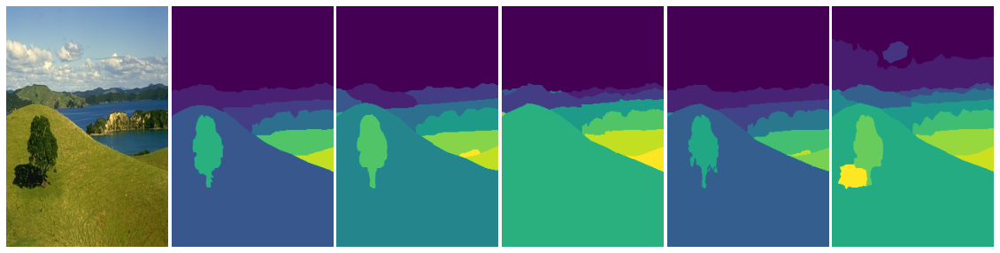

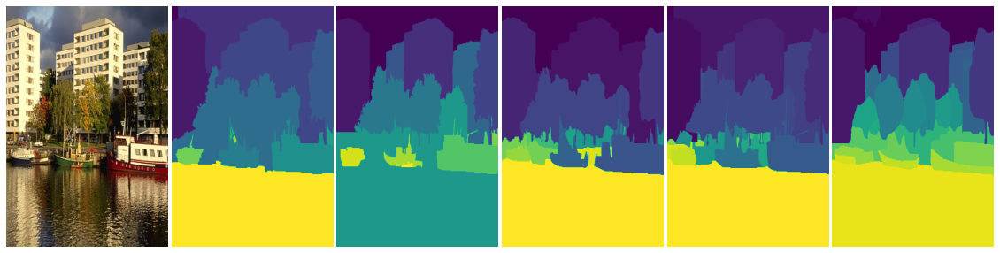

In [ ]:
# Visualize the image and the ground truth segmentation
DisplayImgGroundTruth(22)
DisplayImgGroundTruth(30)

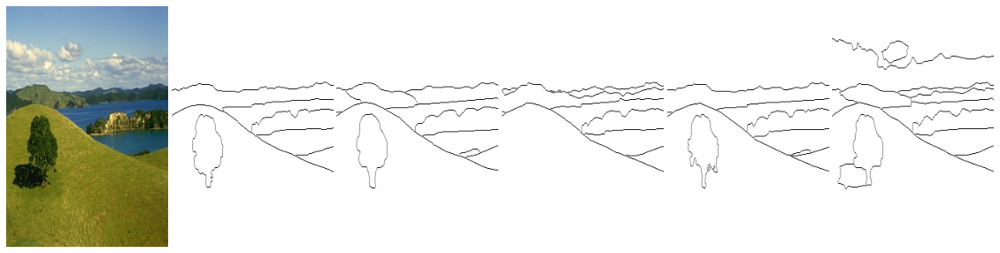

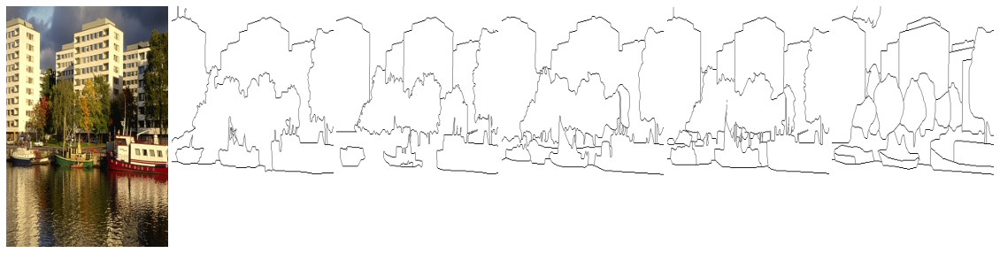

In [ ]:
# Visualize the image and the ground truth CONTOUR segmentation
WITH_CONTOUR = True
DisplayImgGroundTruth(22, WITH_CONTOUR)
DisplayImgGroundTruth(30, WITH_CONTOUR)

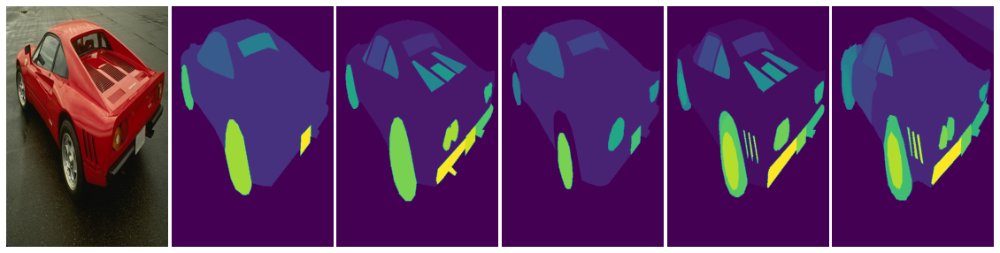

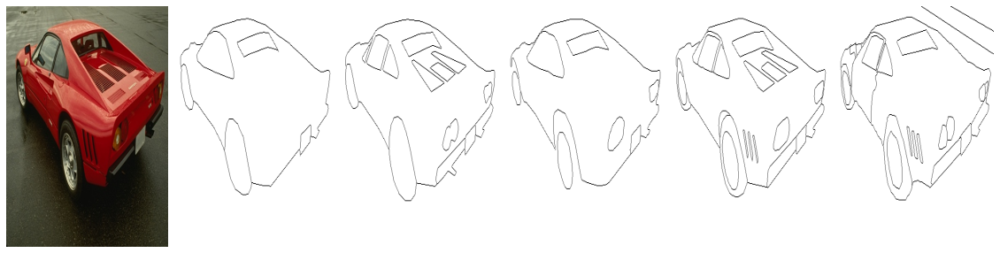

In [ ]:
# BOTH TOGTHER
DisplayImgGroundTruth(31)
DisplayImgGroundTruth(31, WITH_CONTOUR)



---



## PART 3 :: Segmentation using K-means
- We will change the K of the K-means algorithm between {3,5,7,9,11} clusters. You will produce different segmentations and save them as colored images. Every color represents a certain group (cluster) of pixels.
- We will evaluate the result segmentation using F-measure, Conditional Entropy for image I with M available ground-truth segmentations. 
- For a clustering of K-clusters you will report your measures M times and the average of the M trials as well.

In [ ]:
# Segmentation using K-means
def Segmentation(index):

  # Get img and it's dimentions
  testImg = orginalTestImgs[index]
  width = testImg.shape[0]
  height = testImg.shape[1]

  f, axes = plt.subplots(1, 6, figsize=(20,5))
  # change the K of the K-means algorithm between {3,5,7,9,11} clusters.
  k = [3,5,7,9,11]
  
  seg = []
  fmeasure = np.zeros((5,5))
  entropy = np.zeros((5,5))

  # loop for the 5 values.
  for idx in range(5):
    kmeans = KMeans(n_clusters = k[idx])
    kmeans.fit(testImgs[index]) 
    labels = kmeans.predict(testImgs[index])
    
    # Evaluate the result segmentation using F-measure, Conditional Entropy
    for h in range(5):
      # Two helper fncs
      fmeasure[idx][h] = CalculateFmeasure(groundTruthImgs[index * 5 + h], labels, k[idx])
      entropy[idx][h] = CalculateConditionalEntropy(groundTruthImgs[index * 5 + h], labels, k[idx])
    
    centers = kmeans.cluster_centers_
    centers = np.uint8(centers)
    segmentedData = centers[labels.flatten()]
    segmentedImg = segmentedData.reshape((testImg.shape))
    segmentedImg = np.array([j for j in kmeans.labels_]).reshape(width, height) 
    seg.append(segmentedImg)

  axes[0].imshow(testImg, aspect='auto')
  axes[0].axis('off')

  for idx in range(1,6):
    axes[idx].imshow(seg[idx - 1] , aspect='auto')
    axes[idx].axis('off')

  print('\n ** Average fmeasure for each K **')
  print(np.mean(fmeasure, axis=1))
  totalfmeasures[index]=np.mean(fmeasure,axis=1)
  print(' ** Average entropy for each K **')
  print(np.mean(entropy, axis=1))
  totalentropy[index]=np.mean(entropy,axis=1)
  plt.subplots_adjust(wspace=0.02,hspace=0.02)
  plt.show()

In [ ]:
# Evaluate the result segmentation using F-measure.
def CalculateFmeasure(y_true, y_pred, k):
  contingencyMatrix = metrics.cluster.contingency_matrix(y_true, y_pred).T
  perc = []
  recall = []
  fmeasure = 0

  for i in range(contingencyMatrix.shape[0]):
    perc.append(max(contingencyMatrix[i]) / np.sum(contingencyMatrix[i]))
    maxindex = np.argmax(contingencyMatrix[i])
    recall.append(max(contingencyMatrix[i]) / np.sum(contingencyMatrix[:,maxindex]))
    fmeasure = fmeasure + (2*perc[i]*recall[i])/(perc[i]+recall[i])

  return fmeasure / k

In [ ]:
# Evaluate the result segmentation using Conditional Entropy.
def CalculateConditionalEntropy(y_true, y_pred, k):

  contingencyMatrix = metrics.cluster.contingency_matrix(y_true, y_pred).T
  temp = 0
  HSC = []
  
  for i in range(contingencyMatrix.shape[0]):
      for j in range(contingencyMatrix.shape[1]):
        denim = 0
        
        if contingencyMatrix[i][j] / np.sum(contingencyMatrix[i]) != 0:
          denim = np.log10(contingencyMatrix[i][j] / np.sum(contingencyMatrix[i]))
        
        temp += (-contingencyMatrix[i][j] / np.sum(contingencyMatrix[i])) * denim

      HSC.append(temp)
      temp = 0

  HSC = np.array(HSC)
  HSCResult = 0
  
  for i in range(contingencyMatrix.shape[0]):
    temp = np.sum(contingencyMatrix[i])/ np.sum(contingencyMatrix)
    HSCResult += temp * HSC[i]

  return HSCResult


 ** Average fmeasure for each K **
[0.65280064 0.523799   0.48345054 0.43149217 0.39951524]
 ** Average entropy for each K **
[0.40161859 0.34366318 0.32306198 0.31877899 0.28334161]


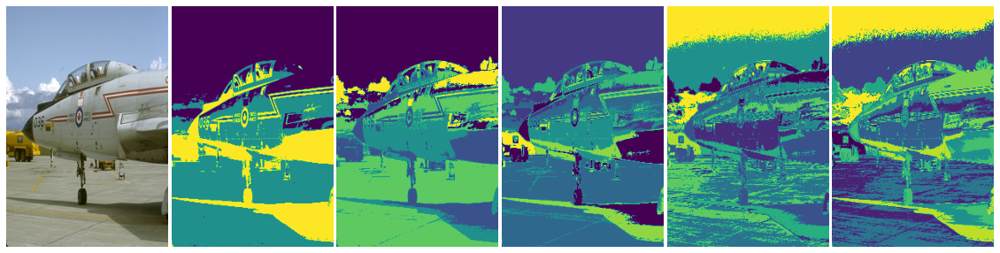

In [ ]:
Segmentation(20)



---



---



## PART 4 :: Big Picture


### 4.A  
- Select a set of five images and display their corresponding ground truth against your segmentation results using K-means at K=5.

In [ ]:
def SegmentationAganistGroundTruth(index):
  seg = []
  for j in range(5): 
    print("\n\nSegmentation results for img nb = " + str(j + 1) + " using K-means at k = 5") 
    SegmentationK5(index + j)
    DisplayImgGroundTruth(index + j)

In [ ]:
def SegmentationK5(index):
  seg = []
  kmeans = KMeans(n_clusters = 5)
  kmeans.fit(testImgs[index]) 
  labels = kmeans.predict(testImgs[index])
  
  centers = kmeans.cluster_centers_
  centers = np.uint8(centers)
  segmentedData = centers[labels.flatten()]
  segmentedImg= segmentedData.reshape((orginalTestImgs[index].shape))
  segmentedImg = np.array([j for j in kmeans.labels_]).reshape(orginalTestImgs[index].shape[0],orginalTestImgs[index].shape[1])
  seg.append(segmentedImg)
  plt.imshow(segmentedImg, aspect='auto')
  plt.show()

### 4.B
- Select the same five images and display their corresponding ground truth against your segmentation results using Normalized-cut for the 5- NN graph, at K=5. 

In [ ]:
# 4-b
def spectralClustering(index, scale_percent):
  
  print("Dimentions before: " + str(orginalTestImgs[index].shape))

  # Reshaped Height and Width
  width = int(orginalTestImgs[index].shape[0] * scale_percent / 100)
  height = int(orginalTestImgs[index].shape[1] * scale_percent / 100)
  dim = (width, height)
  print("Dimentions After: " + str(dim))
  
  img = orginalTestImgs[index]
  
  resized = cv2.resize(img, dim)
  resizedTestImg = (resized).reshape(-1 ,3)

  
  cluster = SpectralClustering(n_clusters=5, affinity='nearest_neighbors', n_neighbors=5).fit_predict(resizedTestImg)
  fmeasure = np.zeros((1,5))
  entropy = np.zeros((1,5))
  segmentedResults = np.array([j for j in cluster]).reshape(height,width)
  
  dim2 = (segmentedResults.shape[0],segmentedResults.shape[1])
  for h in range(5):
     x = cv2.resize(groundTruthImgs[index * 5 + h], dim2)
     fmeasure[0][h] = CalculateFmeasure(x, segmentedResults, 5)
     entropy[0][h] = CalculateConditionalEntropy(x, segmentedResults, 5)
  print('Average fmeasure for each K')
  print(np.mean(fmeasure,axis=1))
  print('Average entropy for each K')
  print(np.mean(entropy,axis=1))   

  print("\n\n\t\t** REAL IMAGE **")
  plt.imshow(img, aspect='auto')
  plt.show()
  print("\n\t** CLUSTERED IMAGE WITH RATIO: " + str(scale_percent) + "% **")
  plt.imshow(segmentedResults, aspect='auto')
  plt.show()
 



Segmentation results for img nb = 1 using K-means at k = 5


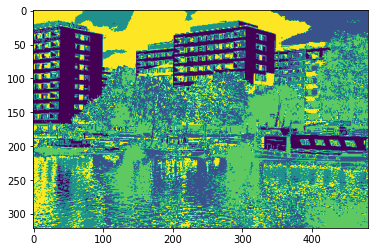

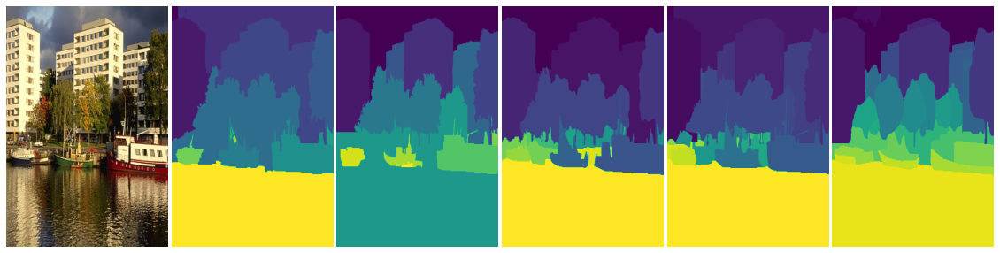



Segmentation results for img nb = 2 using K-means at k = 5


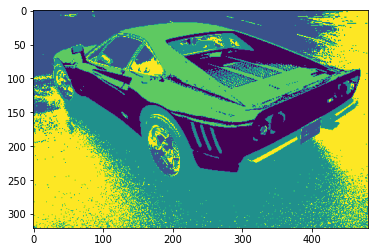

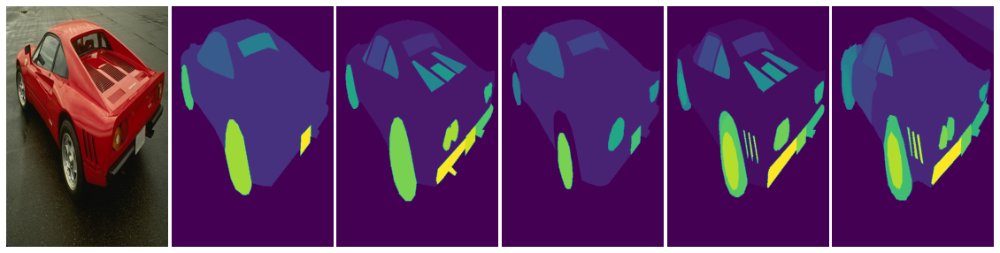



Segmentation results for img nb = 3 using K-means at k = 5


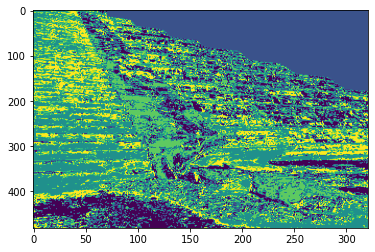

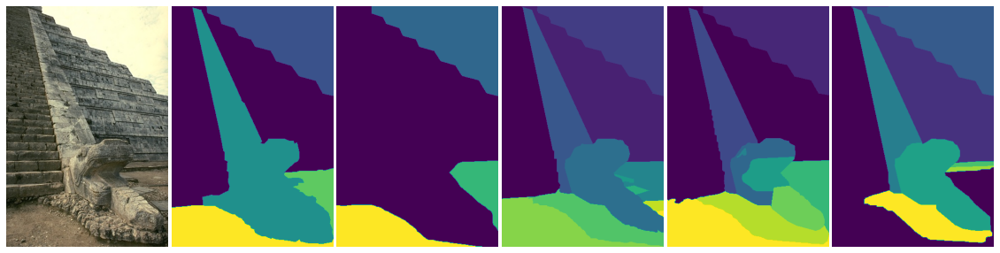



Segmentation results for img nb = 4 using K-means at k = 5


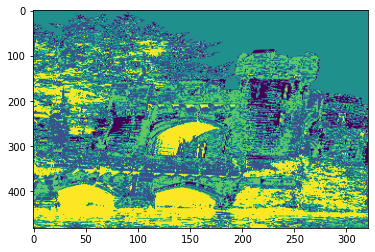

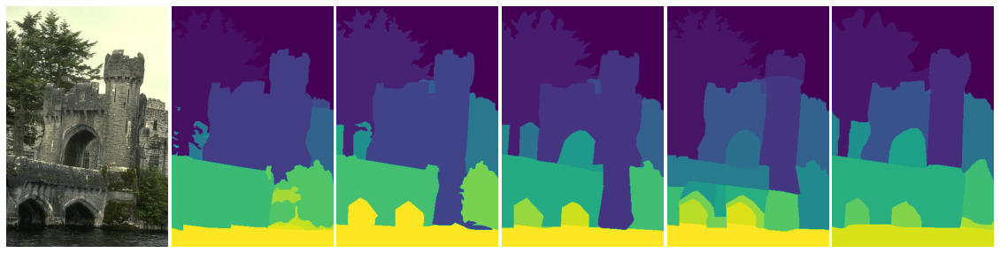



Segmentation results for img nb = 5 using K-means at k = 5


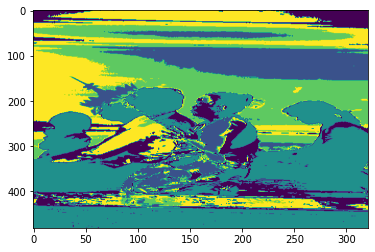

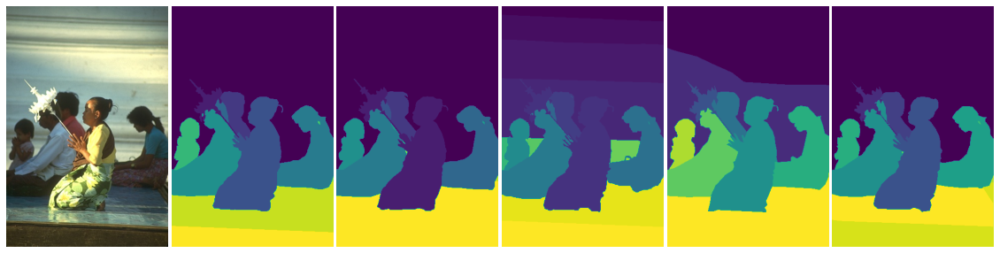

In [ ]:
# 4.A
SegmentationAganistGroundTruth(30)

Dimentions before: (321, 481, 3)
Dimentions After: (32, 48)
Average fmeasure for each K
[0.36099124]
Average entropy for each K
[0.48671911]


		** REAL IMAGE **


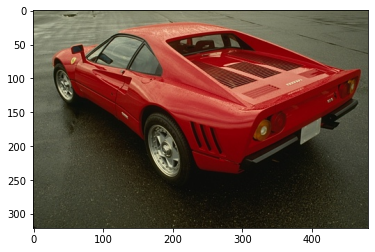


	** CLUSTERED IMAGE WITH RATIO: 10% **


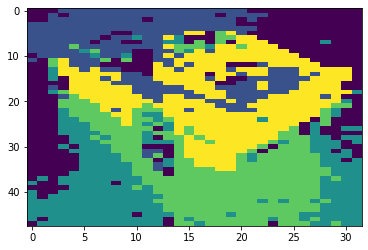

In [ ]:
# 4. B
# WITH RATIO 10%
spectralClustering(31, 10)

Dimentions before: (321, 481, 3)
Dimentions After: (48, 72)


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Average fmeasure for each K
[0.30502349]
Average entropy for each K
[0.51981292]


		** REAL IMAGE **


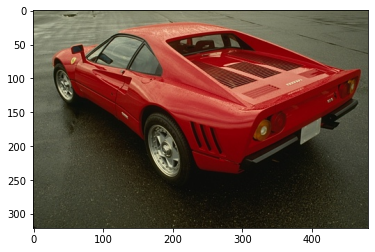


	** CLUSTERED IMAGE WITH RATIO: 15% **


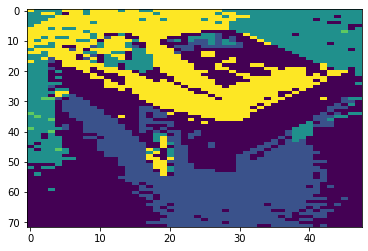

In [ ]:
# WITH RATIO 15%
spectralClustering(31, 15)

Dimentions before: (321, 481, 3)
Dimentions After: (64, 96)


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Average fmeasure for each K
[0.25637693]
Average entropy for each K
[0.52872301]


		** REAL IMAGE **


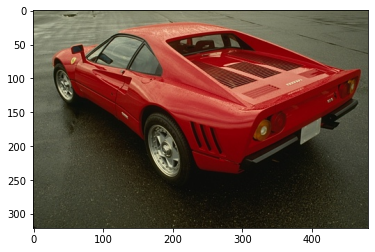


	** CLUSTERED IMAGE WITH RATIO: 20% **


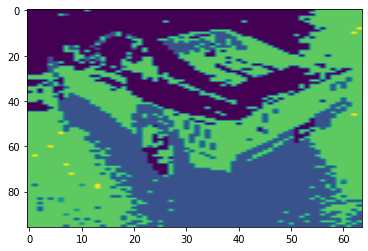

In [ ]:
# WITH RATIO 20%
spectralClustering(31, 20)

### 4.C
- Select the same five images and contrast your segmentation results using Normalized-cut for the 5-NN graph, at K=5 versus using K- means at K=5. 



 **** TESTING IMAGE NUMBER: 1 ***

Normalized-cut for the 5-NN graph result.

Dimentions before: (321, 481, 3)
Dimentions After: (32, 48)


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Average fmeasure for each K
[0.30066969]
Average entropy for each K
[0.29253743]


		** REAL IMAGE **


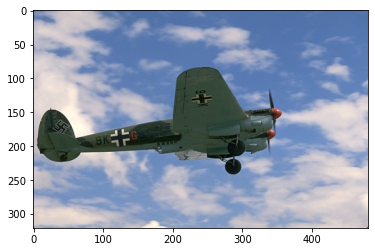


	** CLUSTERED IMAGE WITH RATIO: 10% **


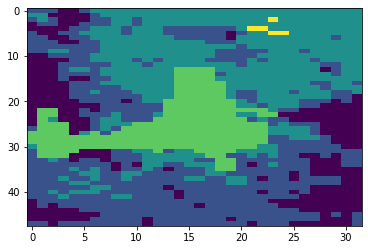


K- means at K = 5 result



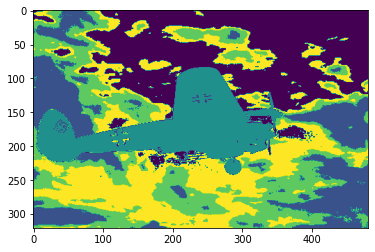



 **** TESTING IMAGE NUMBER: 2 ***

Normalized-cut for the 5-NN graph result.

Dimentions before: (321, 481, 3)
Dimentions After: (38, 57)
Average fmeasure for each K
[0.45959956]
Average entropy for each K
[0.45807705]


		** REAL IMAGE **


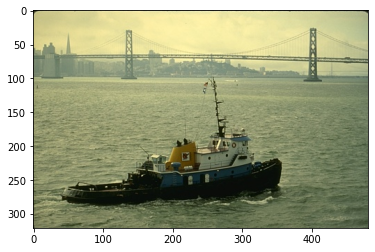


	** CLUSTERED IMAGE WITH RATIO: 12% **


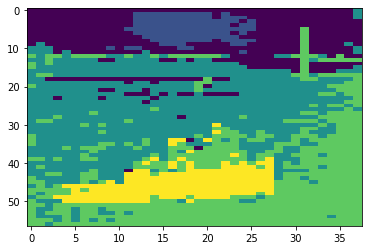


K- means at K = 5 result



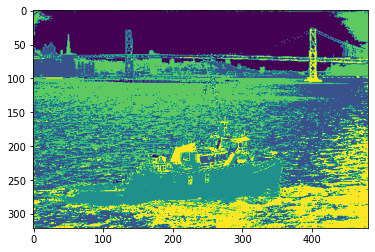



 **** TESTING IMAGE NUMBER: 3 ***

Normalized-cut for the 5-NN graph result.

Dimentions before: (321, 481, 3)
Dimentions After: (44, 67)
Average fmeasure for each K
[0.28235392]
Average entropy for each K
[0.5014491]


		** REAL IMAGE **


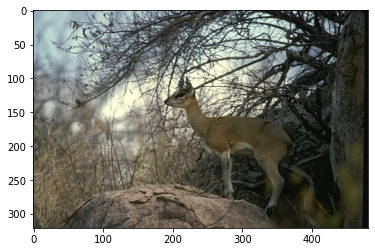


	** CLUSTERED IMAGE WITH RATIO: 14% **


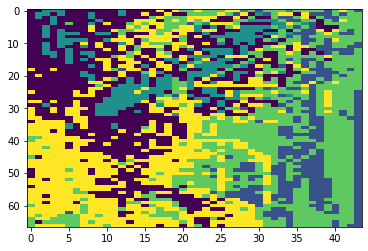


K- means at K = 5 result



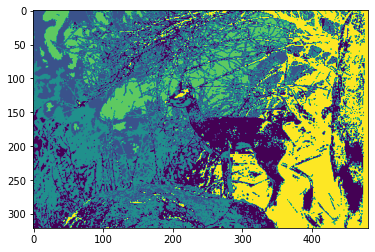



 **** TESTING IMAGE NUMBER: 4 ***

Normalized-cut for the 5-NN graph result.

Dimentions before: (321, 481, 3)
Dimentions After: (51, 76)


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Average fmeasure for each K
[0.20866197]
Average entropy for each K
[0.94282765]


		** REAL IMAGE **


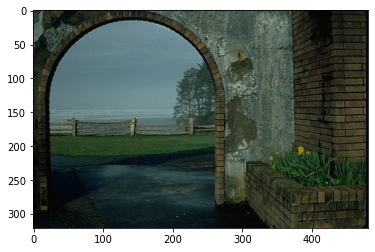


	** CLUSTERED IMAGE WITH RATIO: 16% **


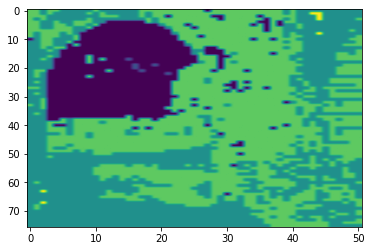


K- means at K = 5 result



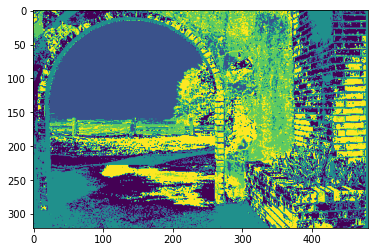



 **** TESTING IMAGE NUMBER: 5 ***

Normalized-cut for the 5-NN graph result.

Dimentions before: (321, 481, 3)
Dimentions After: (57, 86)


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Average fmeasure for each K
[0.16233214]
Average entropy for each K
[0.45253406]


		** REAL IMAGE **


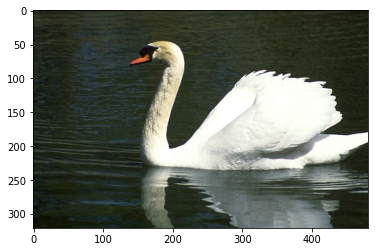


	** CLUSTERED IMAGE WITH RATIO: 18% **


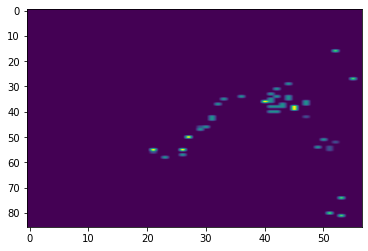


K- means at K = 5 result



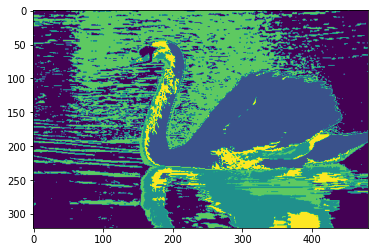

In [ ]:
percentage = 10
for index in range(36, 41):
  print("\n\n **** TESTING IMAGE NUMBER: " + str(index - 35) + " ***\n")
  print("Normalized-cut for the 5-NN graph result.\n")
  spectralClustering(index, percentage)
  print("\nK- means at K = 5 result\n")
  SegmentationK5(index)
  percentage += 2



---



---


## PART 5 :: Extra.
- In the previous parts, we used the color features RGB. We did not encode the layout of the pixels. We want to modify that for K-means clustering to encode the spatial layout of the pixels.
  - i. Suggest a way to modify the feature vector to include spatial layout.
  - ii. Contrast the results you obtained in 4.a to the results you obtained by considering the spatial layout.

In [ ]:
def SpatialDistance(orginalImg, index):
  f, axes = plt.subplots(1,6,figsize=(20,5))
  seg = []
  for i in range(5):
    kmeans = KMeans(n_clusters = 5)
    kmeans.fit(orginalImg) 
    labels = kmeans.predict(orginalImg)
    
    centers = kmeans.cluster_centers_
    centers = np.uint8(centers)
    segmentedData = centers[labels.flatten()]
    segmentedImg = segmentedData.reshape((orginalImg.shape))
    segmentedImg = np.array([j for j in kmeans.labels_]).reshape(orginalTestImgs[index].shape[0],orginalTestImgs[index].shape[1])
    seg.append(segmentedImg)
 
  seg = np.array(seg) 
  axes[0].imshow(orginalTestImgs[index], aspect='auto')

  for i in range(1,6):
    axes[i].imshow(seg[i - 1], aspect='auto')
    axes[i].axis('off')  
  

In [ ]:
def ChoosingSp(index):

  img3d = np.copy(orginalTestImgs[index])
  img2d = img3d[:,:,0]     #   convert to 2D array
  row, col = img2d.shape
  x = []
  y = []
  for i in range(row):
      for j in range(col):
            x.append(i) #       get x indices
            y.append(j) #       get y indices
  
  x = np.array(x).reshape(img3d.shape[0]*img3d.shape[1],1)
  y = np.array(y).reshape(img3d.shape[0]*img3d.shape[1],1)
  img3d2 = img3d.reshape(img3d.shape[0]*img3d.shape[1],3)
  
  finalImg = np.append(img3d2,x,axis = 1)
  finalImg = np.append(finalImg,y,axis = 1)
  finalImg = finalImg.reshape(img3d.shape[0], img3d.shape[1],5)
  x = finalImg.reshape((-1,5))
  x = np.float32(x)
  SpatialDistance(x, index)


*** FOR IMAGE NB: 1 ***

 ** Average fmeasure for each K **
[0.77227638 0.68822726 0.5365043  0.45624134 0.3830287 ]
 ** Average entropy for each K **
[0.40756581 0.3556064  0.29999994 0.29422647 0.28550101]


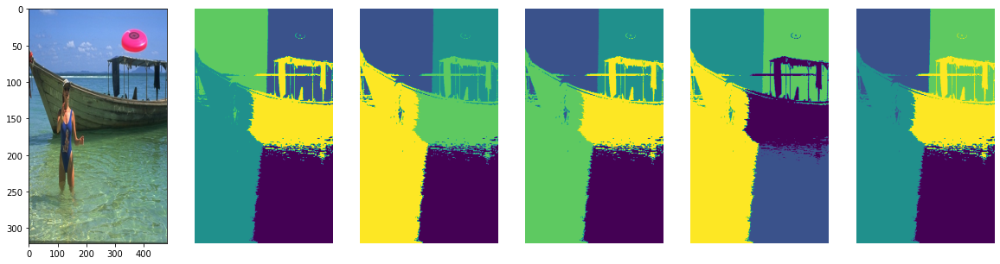

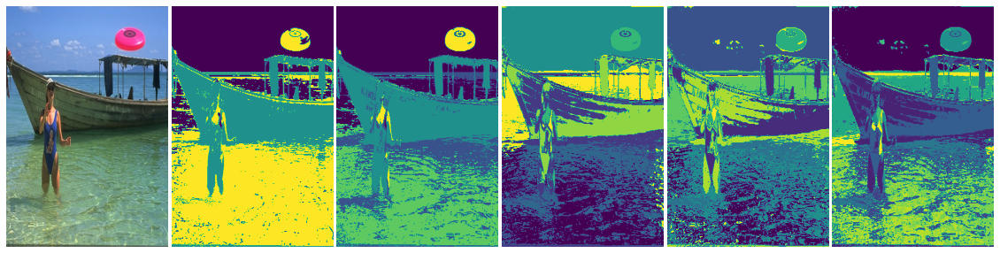


*** FOR IMAGE NB: 2 ***

 ** Average fmeasure for each K **
[0.52405228 0.55543723 0.51871541 0.42620707 0.37223929]
 ** Average entropy for each K **
[0.69052655 0.5565094  0.47708612 0.47492468 0.46577183]


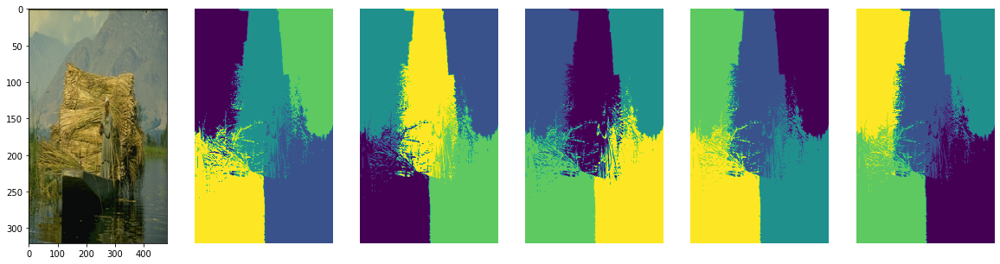

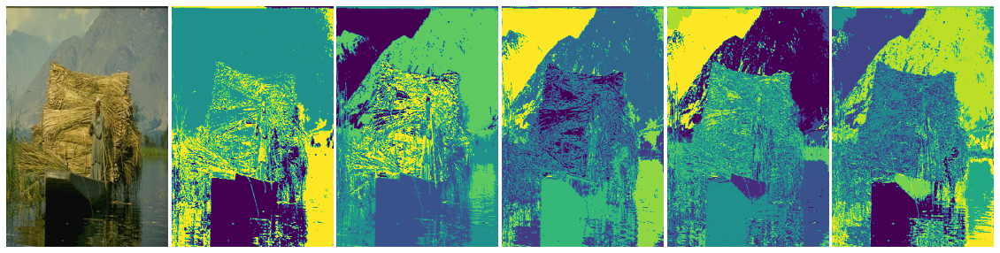


*** FOR IMAGE NB: 3 ***

 ** Average fmeasure for each K **
[0.54620979 0.58842676 0.54211773 0.45720211 0.40137796]
 ** Average entropy for each K **
[0.47451417 0.40340965 0.33938226 0.3340142  0.29914211]


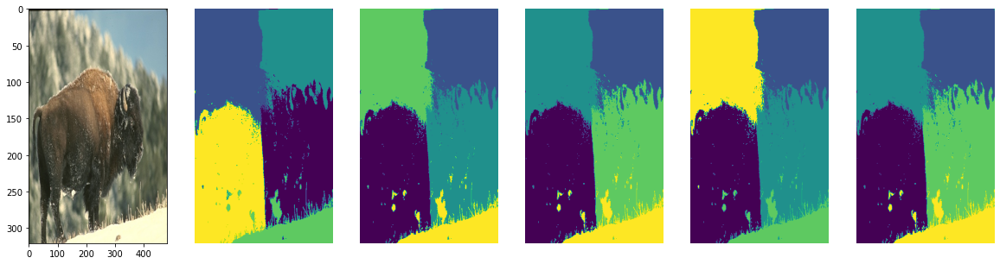

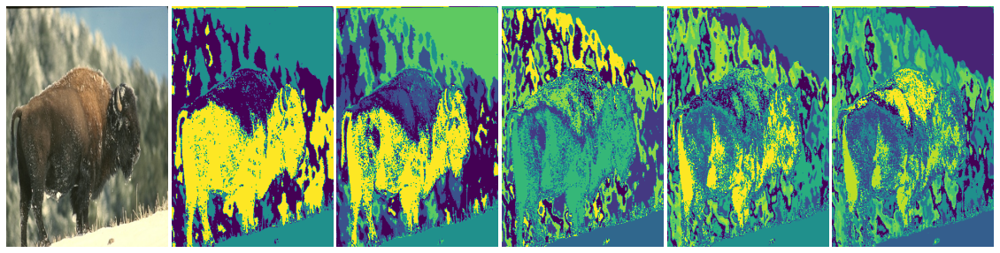


*** FOR IMAGE NB: 4 ***

 ** Average fmeasure for each K **
[0.65959034 0.51452032 0.41644953 0.35012869 0.30465179]
 ** Average entropy for each K **
[0.82453867 0.77695816 0.76290071 0.75239583 0.74892834]


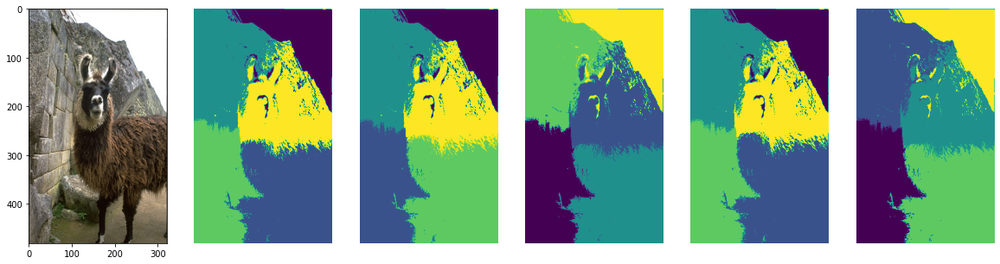

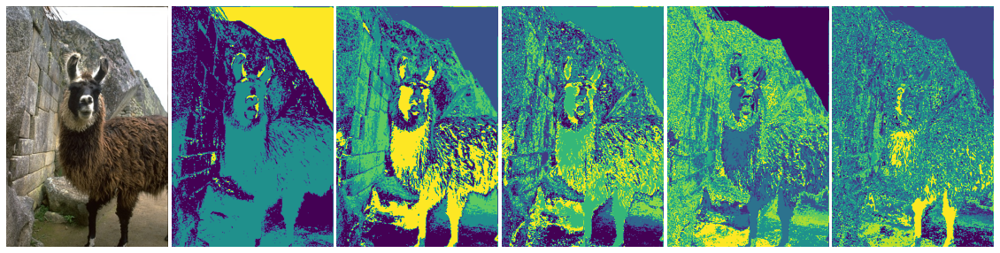


*** FOR IMAGE NB: 5 ***

 ** Average fmeasure for each K **
[0.60667492 0.51600775 0.45210635 0.36536078 0.33278694]
 ** Average entropy for each K **
[0.5425029  0.4738835  0.43441425 0.42006395 0.37175601]


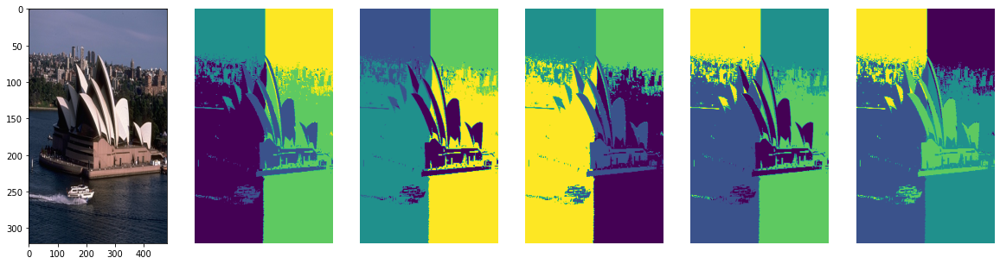

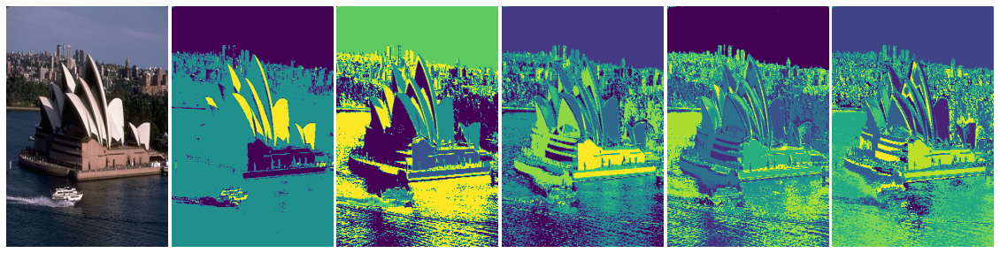

In [ ]:
# Extra..
for index in range(41, 46):
  print("\n*** FOR IMAGE NB: "+ str(index - 40) + " ***")
  ChoosingSp(index)
  Segmentation(index)


Data for image number: 1

 ** Average fmeasure for each K **
[0.39743042 0.42650851 0.35476563 0.33701404 0.31169113]
 ** Average entropy for each K **
[0.775406   0.68451166 0.66704884 0.64619533 0.61885907]


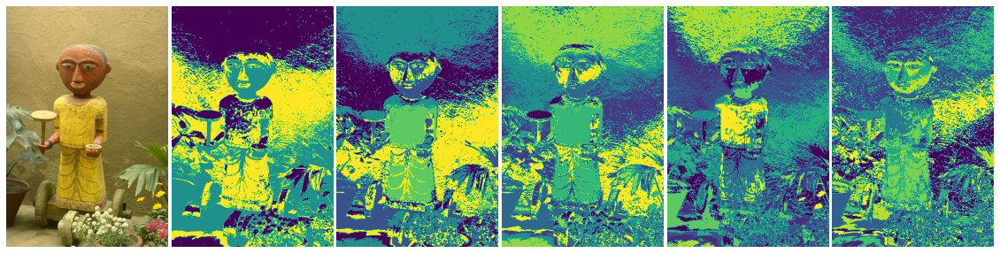


Data for image number: 2

 ** Average fmeasure for each K **
[0.43759623 0.29943243 0.23453916 0.18978721 0.17317045]
 ** Average entropy for each K **
[0.31842193 0.3137691  0.3118563  0.31152326 0.30157331]


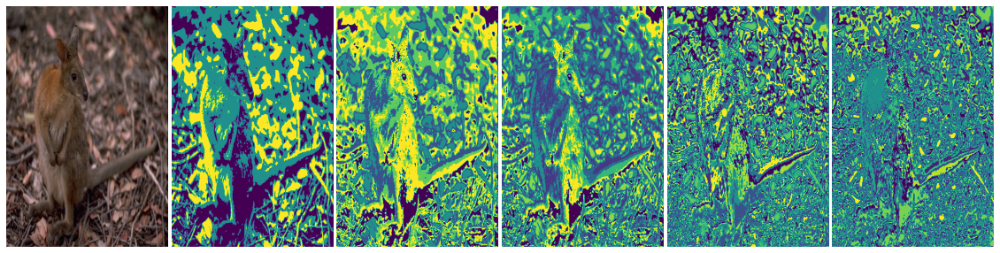


Data for image number: 3

 ** Average fmeasure for each K **
[0.44752755 0.37738674 0.28821848 0.33244867 0.29214755]
 ** Average entropy for each K **
[0.32544595 0.29889157 0.289776   0.27346478 0.27119429]


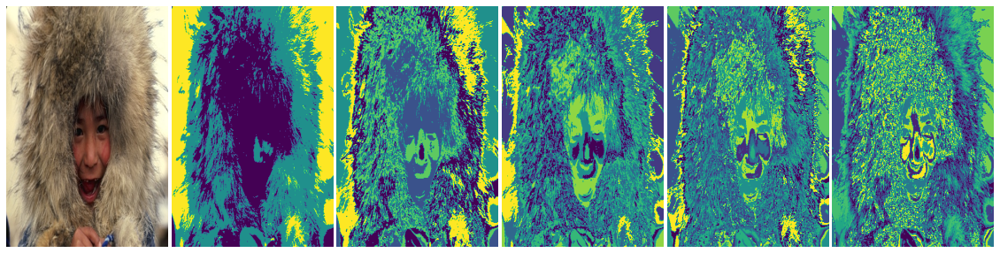


Data for image number: 4

 ** Average fmeasure for each K **
[0.38302782 0.41500203 0.37139461 0.36003843 0.37750349]
 ** Average entropy for each K **
[1.0036932  0.95761637 0.91755875 0.8787018  0.84951898]


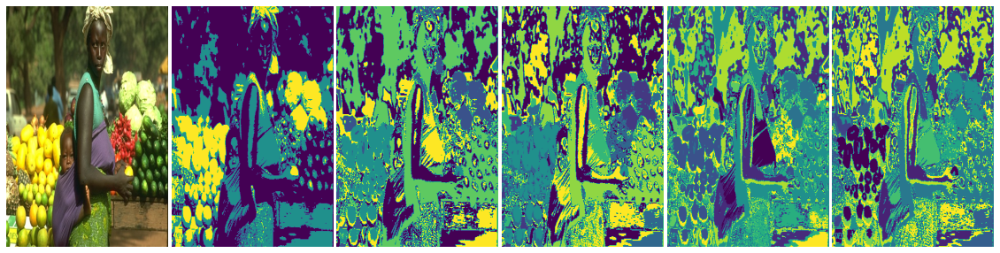


Data for image number: 5

 ** Average fmeasure for each K **
[0.44844588 0.50235324 0.41248935 0.34358205 0.30264141]
 ** Average entropy for each K **
[0.58013681 0.52894443 0.51410637 0.50505803 0.4945683 ]


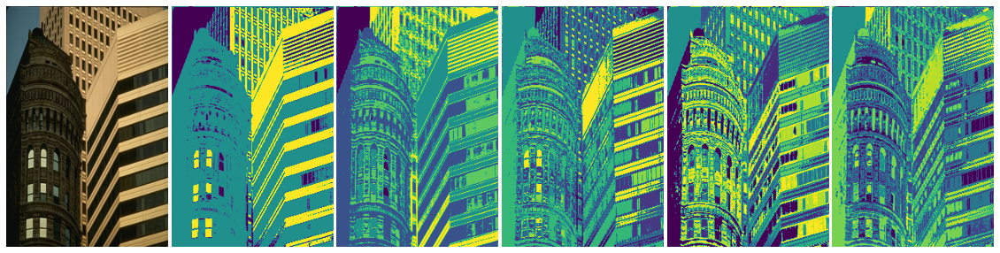


Data for image number: 6

 ** Average fmeasure for each K **
[0.44810079 0.32029168 0.30508749 0.24584764 0.20517647]
 ** Average entropy for each K **
[0.28389314 0.27319778 0.2676441  0.26537277 0.26463079]


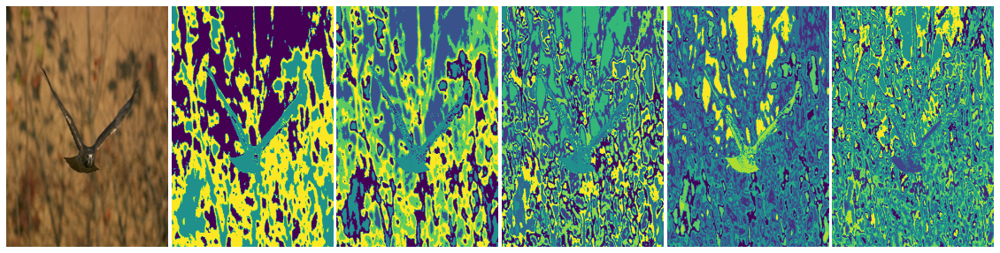


Data for image number: 7

 ** Average fmeasure for each K **
[0.62280295 0.46855098 0.37479813 0.31633128 0.27286453]
 ** Average entropy for each K **
[0.39754502 0.37774503 0.37174804 0.36678579 0.36287293]


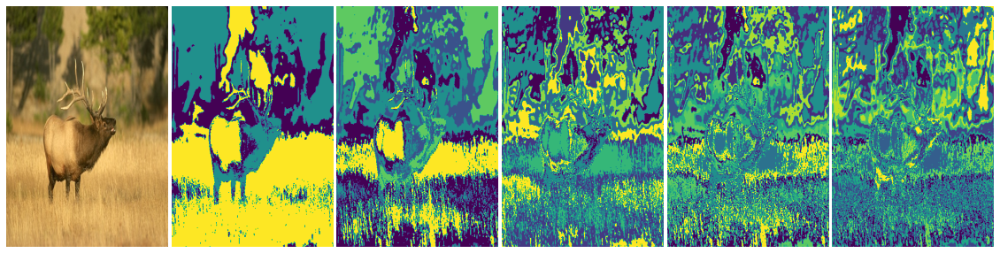


Data for image number: 8

 ** Average fmeasure for each K **
[0.56534618 0.44985576 0.38811184 0.3481358  0.31604934]
 ** Average entropy for each K **
[0.61373949 0.52509251 0.49737462 0.4667331  0.44377795]


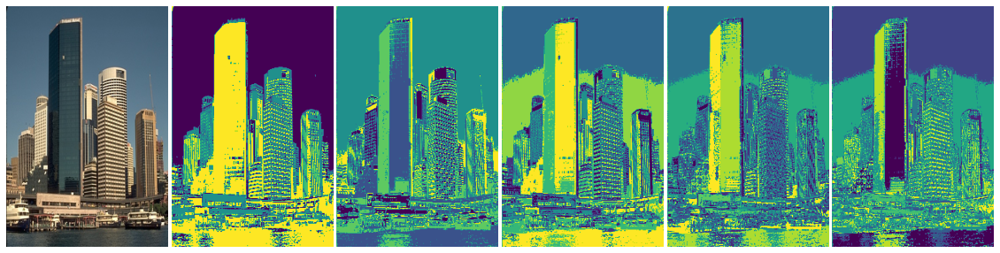


Data for image number: 9

 ** Average fmeasure for each K **
[0.58053144 0.45181179 0.41581414 0.35055876 0.31578881]
 ** Average entropy for each K **
[0.6156127  0.59808749 0.57871366 0.57336019 0.56508816]


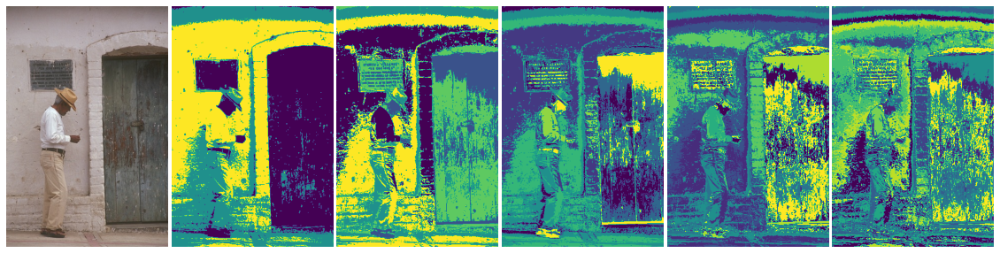


Data for image number: 10

 ** Average fmeasure for each K **
[0.5656628  0.42145558 0.40131239 0.34061186 0.31137054]
 ** Average entropy for each K **
[0.44571534 0.38483216 0.34469096 0.34019554 0.32661054]


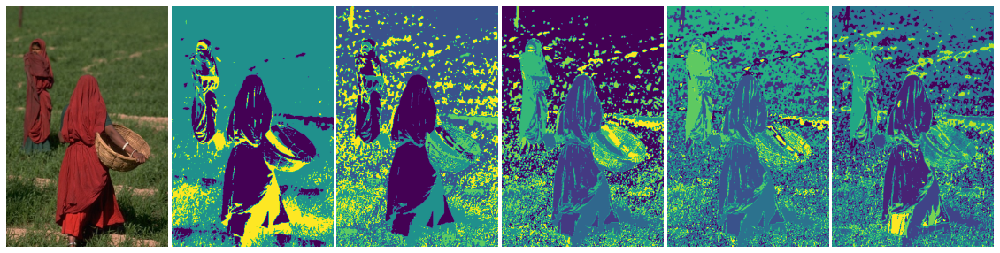


Data for image number: 11

 ** Average fmeasure for each K **
[0.42242624 0.37965301 0.406195   0.35196635 0.31852658]
 ** Average entropy for each K **
[0.63944975 0.613105   0.59726383 0.59212441 0.56738218]


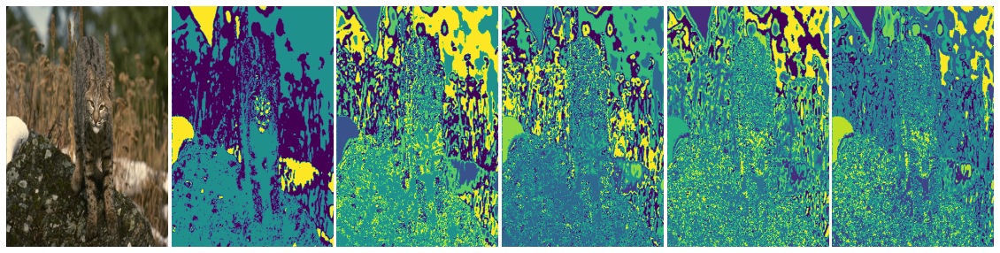


Data for image number: 12

 ** Average fmeasure for each K **
[0.51468928 0.43568285 0.44156354 0.40123903 0.35855687]
 ** Average entropy for each K **
[0.77153036 0.68868766 0.64922624 0.62979633 0.61536508]


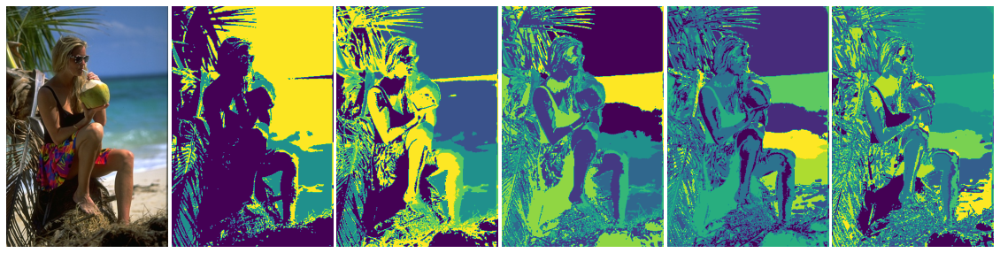


Data for image number: 13

 ** Average fmeasure for each K **
[0.61316034 0.47348525 0.37985074 0.30797994 0.27154535]
 ** Average entropy for each K **
[0.32941772 0.31906434 0.30209008 0.29801558 0.28330884]


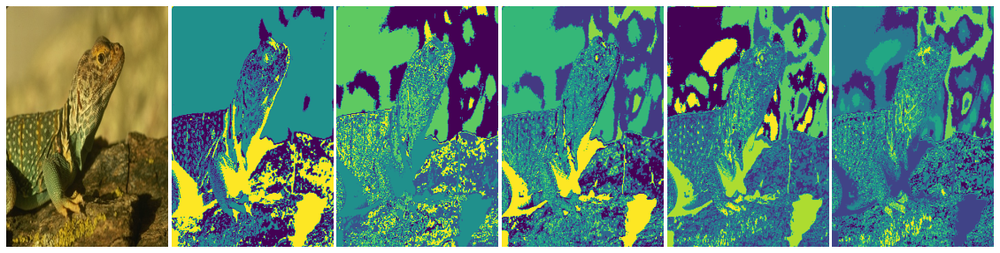


Data for image number: 14

 ** Average fmeasure for each K **
[0.32449967 0.28346585 0.2686347  0.23191237 0.21288452]
 ** Average entropy for each K **
[0.80704293 0.78994195 0.7645336  0.7612133  0.75039646]


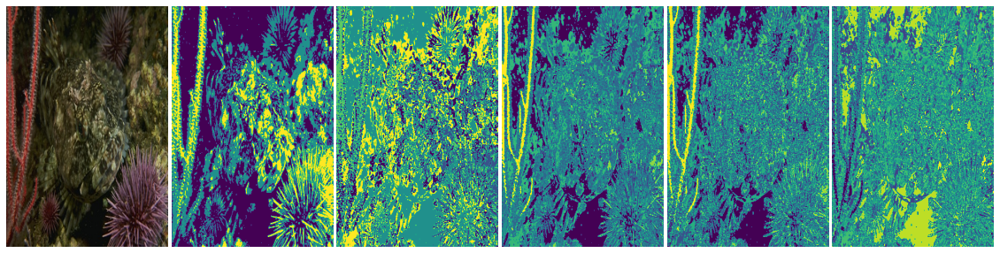


Data for image number: 15

 ** Average fmeasure for each K **
[0.54302603 0.4293101  0.34935694 0.29755575 0.25683751]
 ** Average entropy for each K **
[0.52094283 0.50388204 0.49513073 0.48898697 0.48531301]


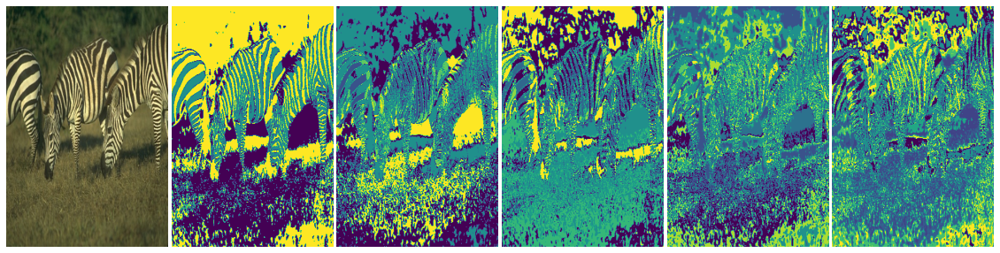


Data for image number: 16

 ** Average fmeasure for each K **
[0.52223091 0.43481087 0.41081804 0.37396072 0.34074573]
 ** Average entropy for each K **
[0.55392641 0.54449282 0.52792103 0.49844293 0.48679417]


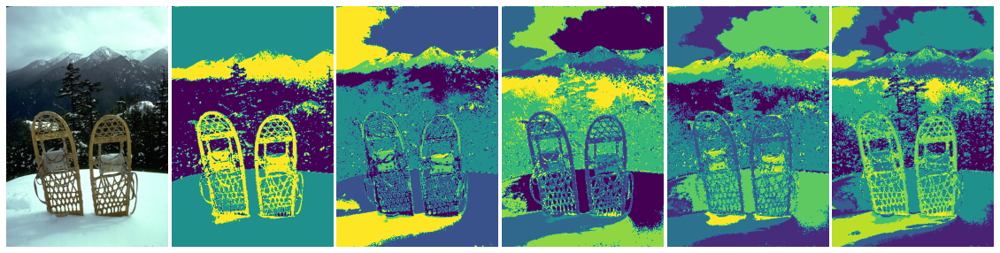


Data for image number: 17

 ** Average fmeasure for each K **
[0.40830258 0.44654746 0.3923423  0.37633656 0.34293099]
 ** Average entropy for each K **
[0.91881975 0.80194063 0.77780696 0.7266228  0.71765585]


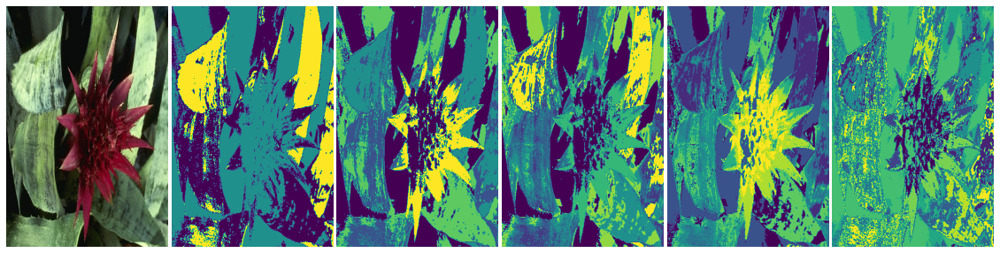


Data for image number: 18

 ** Average fmeasure for each K **
[0.53414889 0.38739322 0.34370395 0.29068656 0.24780933]
 ** Average entropy for each K **
[0.39111651 0.36882783 0.36108352 0.35790509 0.3555498 ]


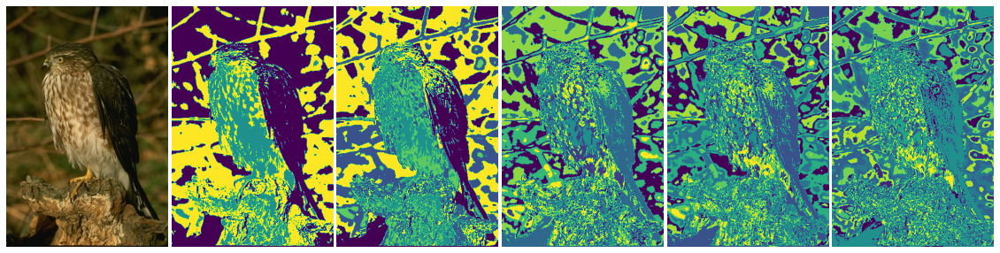


Data for image number: 19

 ** Average fmeasure for each K **
[0.49662834 0.46532694 0.47272804 0.43841371 0.41768792]
 ** Average entropy for each K **
[0.80422784 0.73686505 0.6642639  0.63095212 0.60693972]


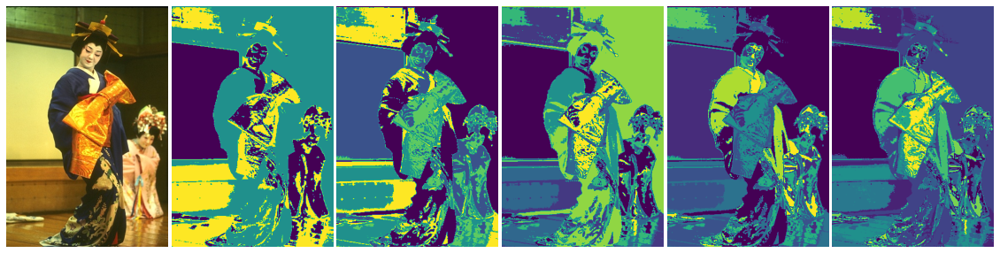


Data for image number: 20

 ** Average fmeasure for each K **
[0.60171078 0.51067716 0.43288156 0.38402963 0.3380614 ]
 ** Average entropy for each K **
[0.53647112 0.48267996 0.45218414 0.44183616 0.41301926]


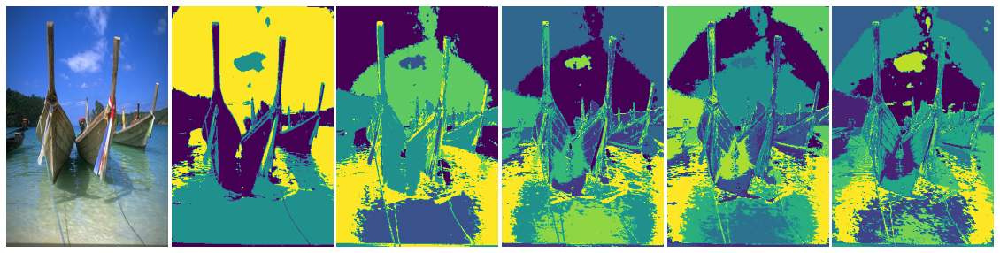


Data for image number: 21

 ** Average fmeasure for each K **
[0.65283044 0.52455916 0.43259743 0.41090999 0.39952324]
 ** Average entropy for each K **
[0.40160198 0.34318356 0.33756397 0.32630428 0.28263064]


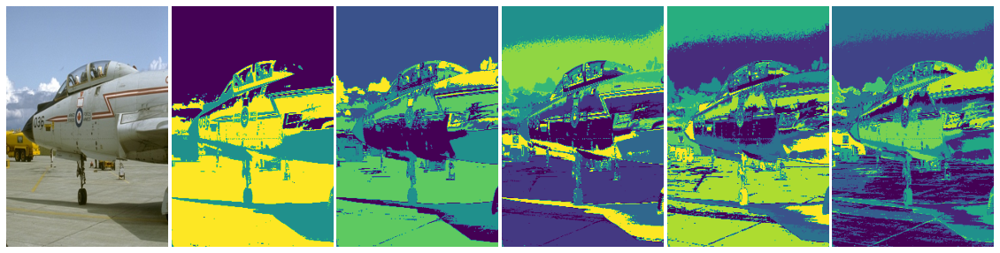


Data for image number: 22

 ** Average fmeasure for each K **
[0.50771001 0.49281518 0.44280247 0.39803524 0.35378373]
 ** Average entropy for each K **
[0.69159875 0.53839583 0.47807505 0.47119749 0.46446353]


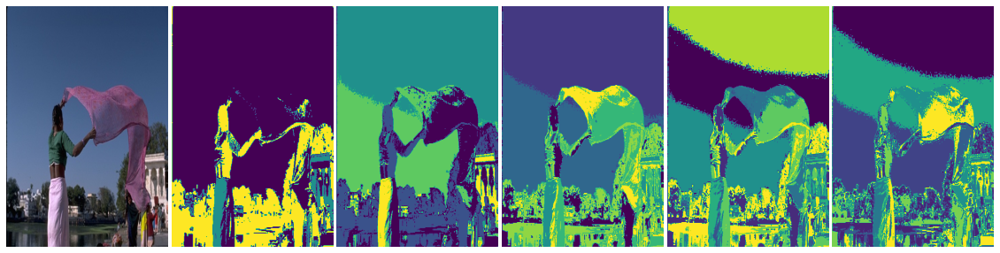


Data for image number: 23

 ** Average fmeasure for each K **
[0.71929024 0.64018704 0.52243522 0.47604139 0.45697648]
 ** Average entropy for each K **
[0.29126552 0.25507086 0.24989018 0.23319139 0.19675636]


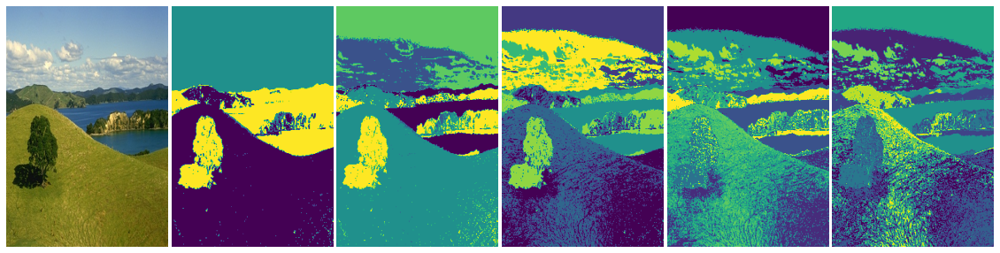


Data for image number: 24

 ** Average fmeasure for each K **
[0.72311392 0.63642504 0.58506614 0.52962086 0.47381184]
 ** Average entropy for each K **
[0.45777004 0.34225633 0.30723484 0.25965442 0.24492155]


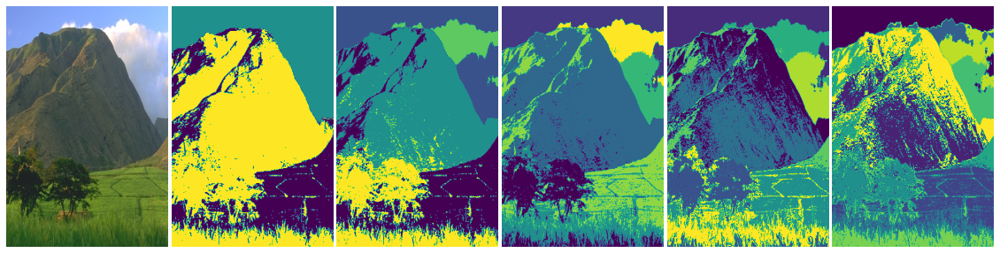


Data for image number: 25

 ** Average fmeasure for each K **
[0.51980863 0.39973761 0.43574788 0.34899773 0.3304832 ]
 ** Average entropy for each K **
[0.4466215  0.41564562 0.39526542 0.38682992 0.35101641]


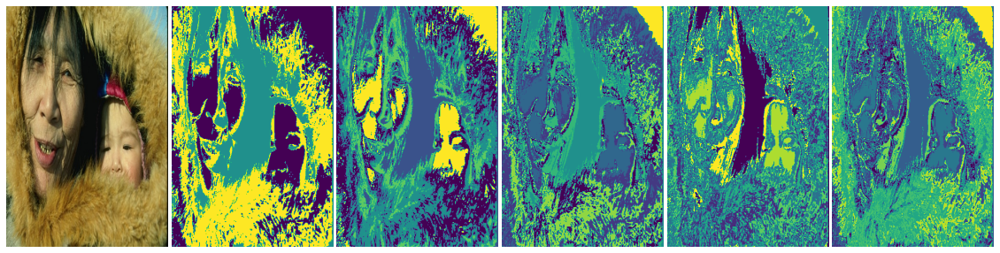


Data for image number: 26

 ** Average fmeasure for each K **
[0.50046269 0.40971312 0.31487751 0.2546874  0.22426433]
 ** Average entropy for each K **
[0.31283667 0.30233127 0.29861411 0.29686549 0.29575367]


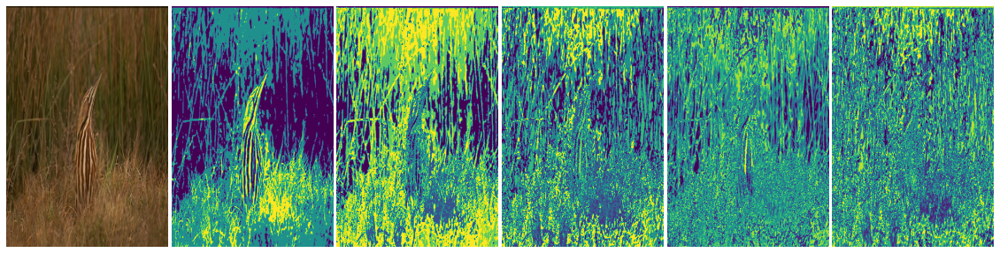


Data for image number: 27

 ** Average fmeasure for each K **
[0.46312026 0.38070444 0.33198133 0.30933236 0.29910489]
 ** Average entropy for each K **
[0.54577356 0.52673581 0.51442259 0.45702023 0.40386419]


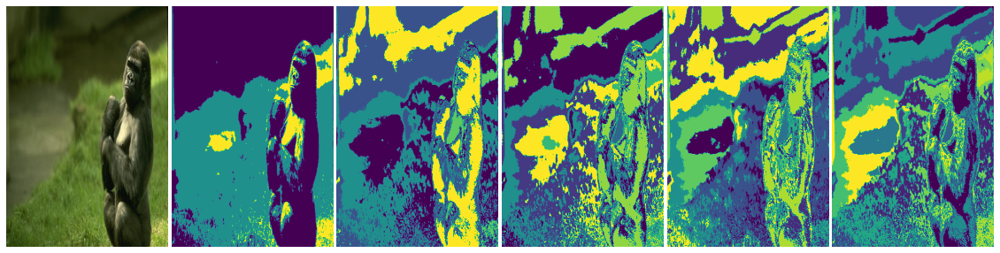


Data for image number: 28

 ** Average fmeasure for each K **
[0.65915102 0.52361134 0.5707442  0.50709015 0.45912553]
 ** Average entropy for each K **
[0.86132869 0.79449545 0.72701537 0.70850799 0.70147578]


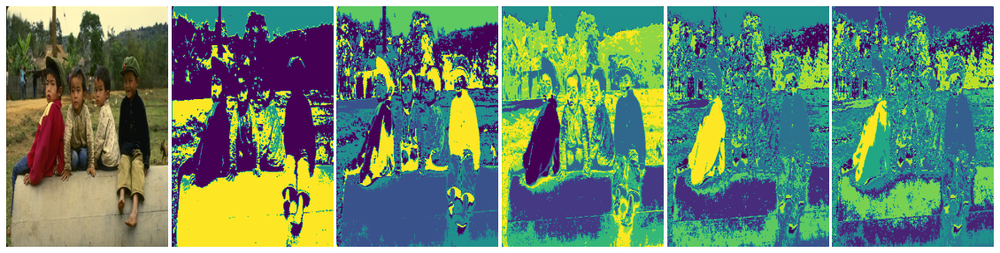


Data for image number: 29

 ** Average fmeasure for each K **
[0.31855328 0.36350155 0.37221905 0.38483597 0.37950637]
 ** Average entropy for each K **
[1.15162062 1.06816851 0.99965795 0.96400755 0.90979142]


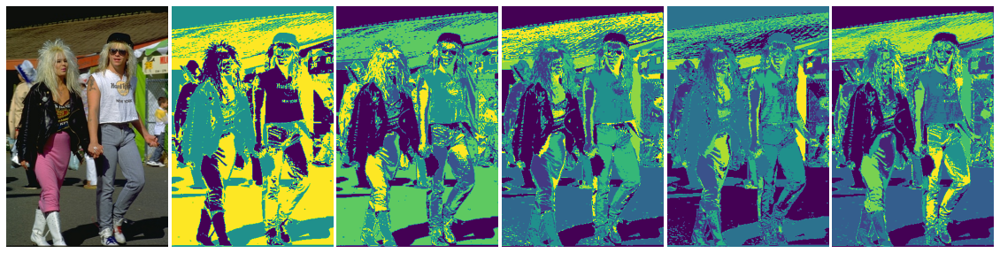


Data for image number: 30

 ** Average fmeasure for each K **
[0.51453678 0.35491749 0.32753182 0.26553182 0.2317807 ]
 ** Average entropy for each K **
[0.14622586 0.12933201 0.12947766 0.12332752 0.10870582]


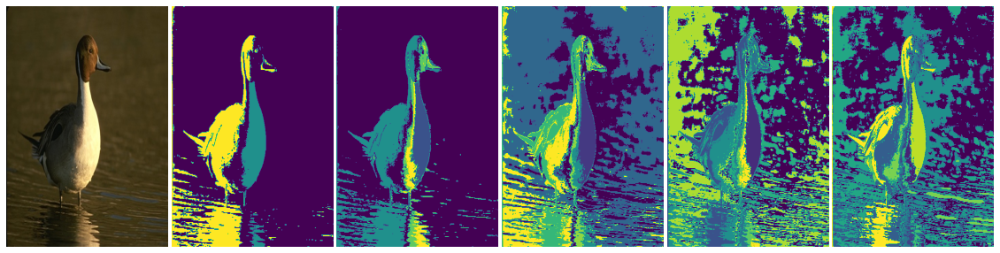


Data for image number: 31

 ** Average fmeasure for each K **
[0.42658535 0.37062713 0.37062339 0.33499491 0.31987881]
 ** Average entropy for each K **
[0.82826191 0.78903937 0.72671378 0.69666547 0.68306063]


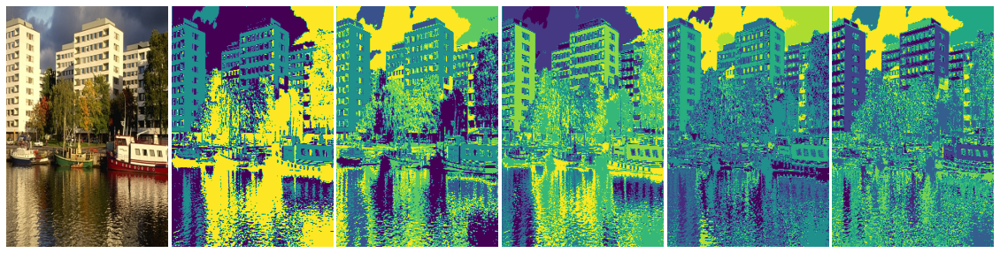


Data for image number: 32

 ** Average fmeasure for each K **
[0.60400283 0.52216929 0.40709699 0.33224815 0.28657349]
 ** Average entropy for each K **
[0.39636727 0.30598481 0.29957451 0.29727649 0.28587155]


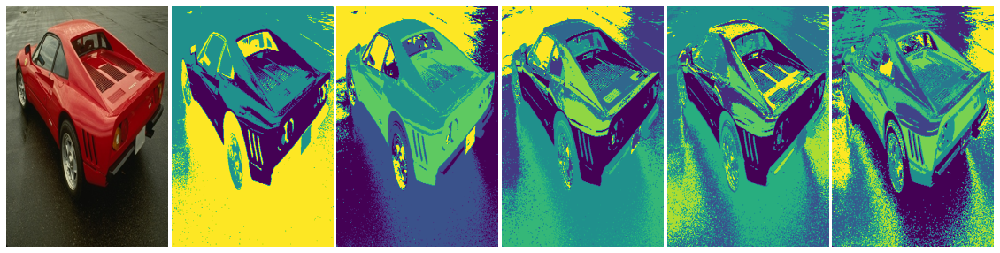


Data for image number: 33

 ** Average fmeasure for each K **
[0.67887692 0.51593006 0.3992524  0.33387777 0.32147381]
 ** Average entropy for each K **
[0.47600401 0.4498377  0.44218128 0.43896787 0.40845958]


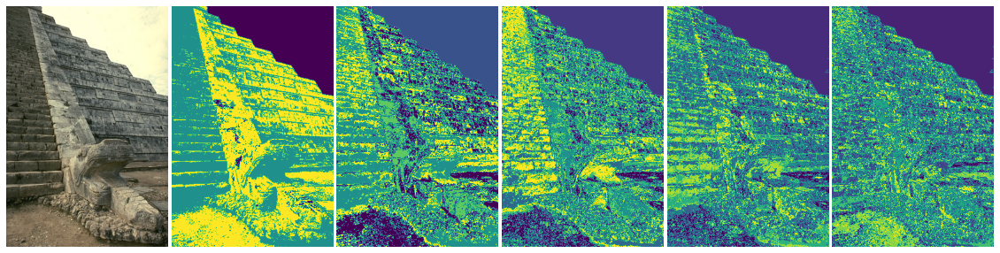


Data for image number: 34

 ** Average fmeasure for each K **
[0.59521634 0.47601428 0.38801222 0.33010349 0.28453054]
 ** Average entropy for each K **
[0.71085453 0.68186382 0.66946678 0.66180627 0.65745899]


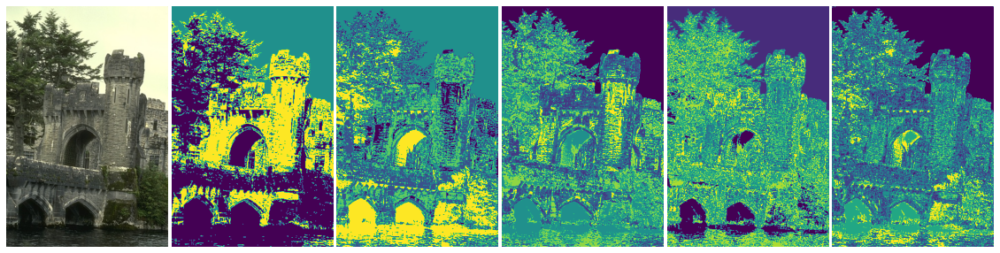


Data for image number: 35

 ** Average fmeasure for each K **
[0.49981375 0.40204753 0.34860704 0.34177135 0.31679329]
 ** Average entropy for each K **
[0.60259796 0.5740582  0.55369548 0.50781195 0.48898358]


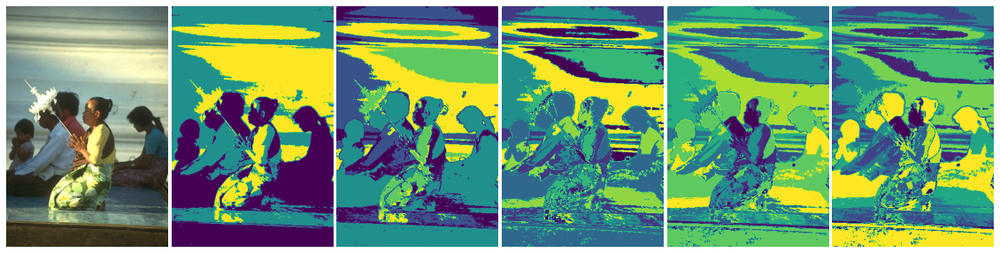


Data for image number: 36

 ** Average fmeasure for each K **
[0.6322457  0.49046758 0.39278833 0.3919214  0.36215469]
 ** Average entropy for each K **
[0.5783024  0.54646875 0.54114124 0.48977749 0.45445356]


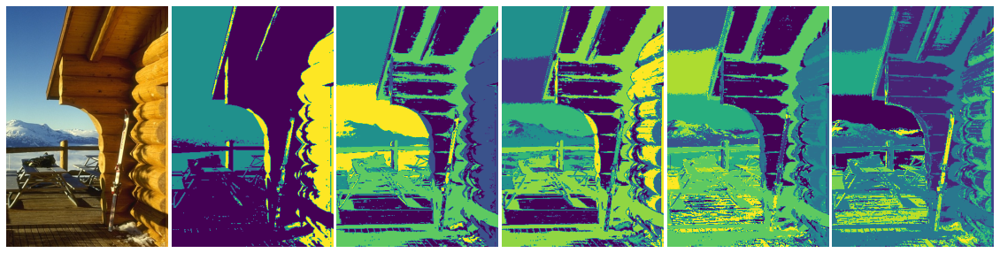


Data for image number: 37

 ** Average fmeasure for each K **
[0.74365696 0.53186024 0.42433962 0.35048265 0.29849351]
 ** Average entropy for each K **
[0.14174814 0.12570137 0.12034219 0.11191623 0.11105634]


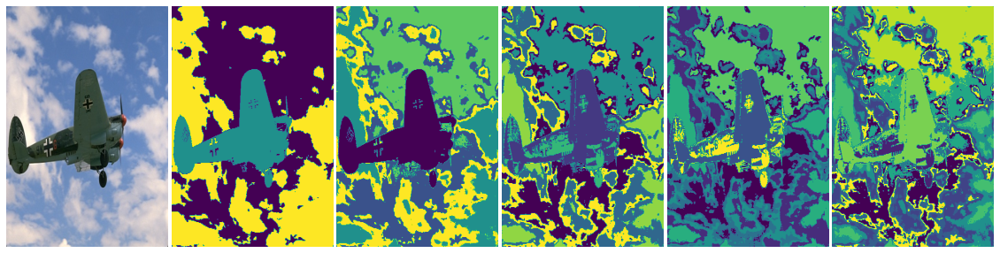


Data for image number: 38

 ** Average fmeasure for each K **
[0.7656806  0.58265032 0.46556406 0.37782876 0.33261929]
 ** Average entropy for each K **
[0.41437417 0.3835302  0.36623888 0.35955457 0.35547624]


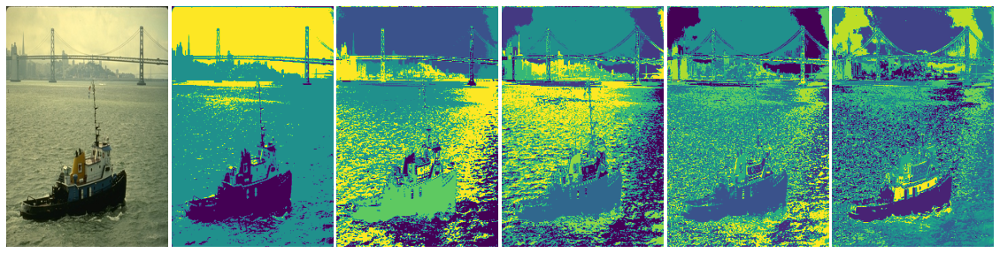


Data for image number: 39

 ** Average fmeasure for each K **
[0.4765365  0.34182307 0.28651877 0.23017863 0.20414419]
 ** Average entropy for each K **
[0.43593284 0.41329789 0.40739603 0.40310721 0.40100164]


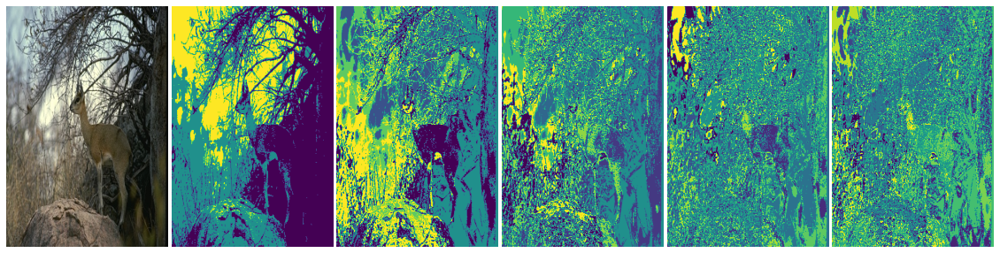


Data for image number: 40

 ** Average fmeasure for each K **
[0.54404736 0.49928969 0.43281094 0.38747158 0.38184653]
 ** Average entropy for each K **
[0.78324032 0.72127497 0.70317986 0.69650604 0.61604903]


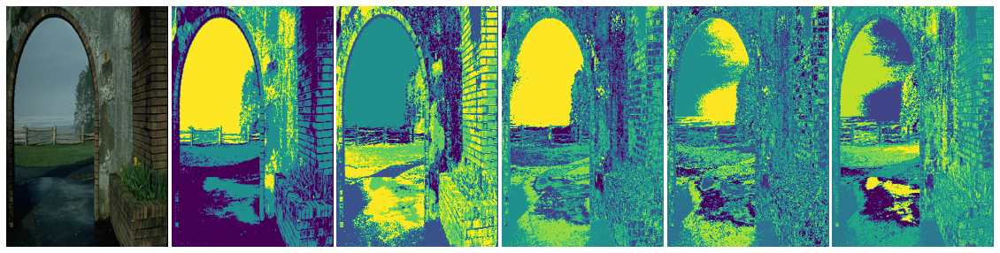


Data for image number: 41

 ** Average fmeasure for each K **
[0.82208114 0.58658534 0.47997079 0.40132055 0.34146312]
 ** Average entropy for each K **
[0.19845311 0.18693731 0.17878018 0.1745405  0.17245313]


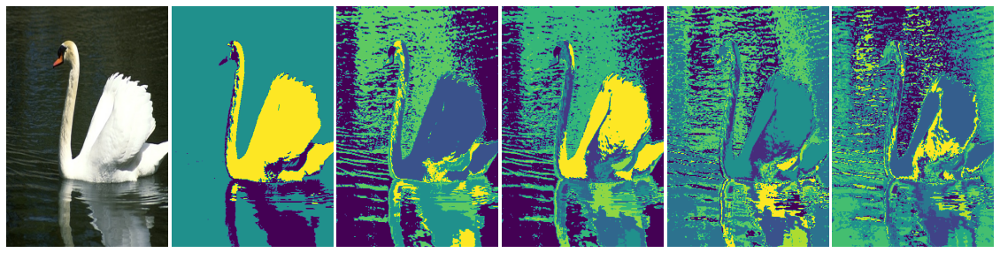


Data for image number: 42

 ** Average fmeasure for each K **
[0.77220722 0.68803125 0.53728969 0.45637363 0.38232785]
 ** Average entropy for each K **
[0.4075698  0.35541535 0.30023994 0.29418089 0.28560069]


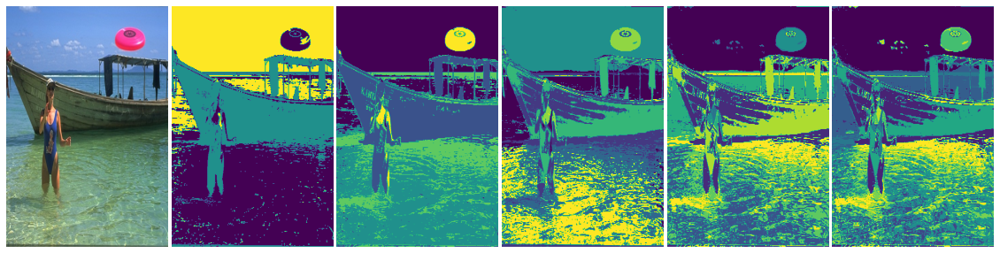


Data for image number: 43

 ** Average fmeasure for each K **
[0.52400102 0.55484366 0.51871102 0.42674225 0.37335611]
 ** Average entropy for each K **
[0.69055288 0.55692318 0.47742529 0.47516339 0.46609021]


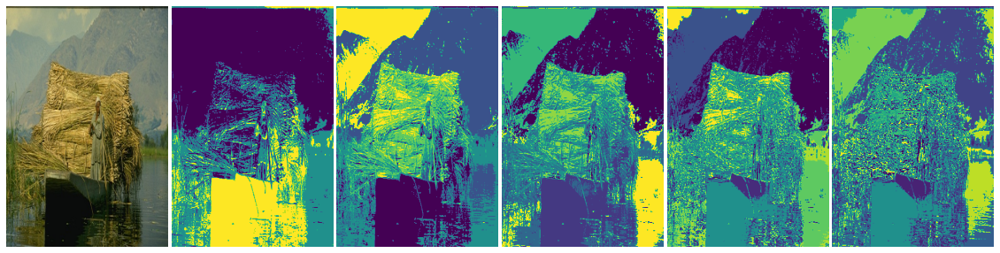


Data for image number: 44

 ** Average fmeasure for each K **
[0.54541192 0.58939615 0.54200025 0.45730984 0.40175678]
 ** Average entropy for each K **
[0.47479016 0.40303882 0.33933997 0.33364214 0.30000152]


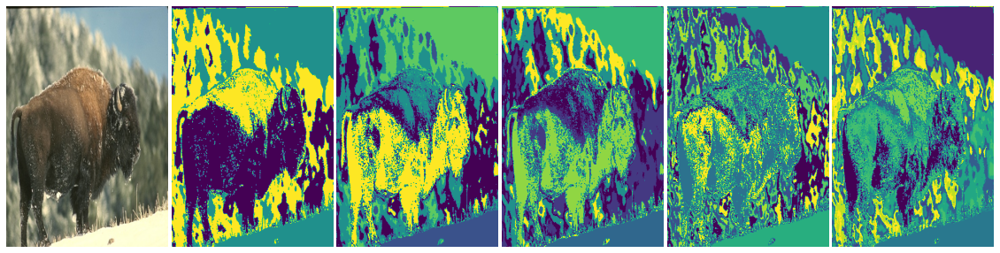


Data for image number: 45

 ** Average fmeasure for each K **
[0.6596068  0.51346856 0.41794814 0.34955348 0.30604982]
 ** Average entropy for each K **
[0.82453207 0.77656785 0.76298766 0.75264532 0.74878555]


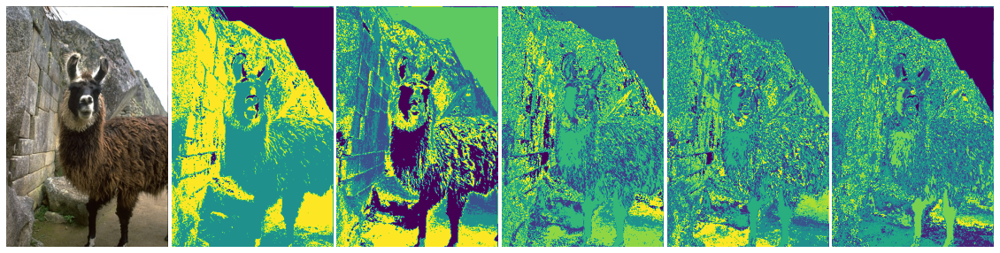


Data for image number: 46

 ** Average fmeasure for each K **
[0.60666997 0.51600775 0.45217891 0.36509402 0.32763041]
 ** Average entropy for each K **
[0.54250665 0.4738835  0.4345131  0.42025046 0.38006709]


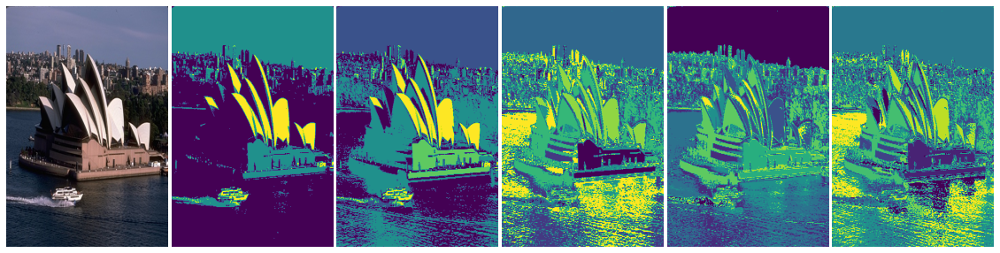


Data for image number: 47

 ** Average fmeasure for each K **
[0.5228059  0.48369027 0.39492758 0.33709905 0.29518629]
 ** Average entropy for each K **
[0.41520458 0.37049808 0.35363763 0.33153581 0.3101256 ]


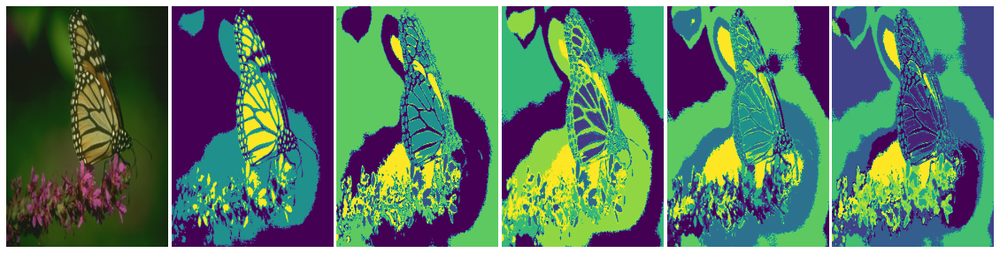


Data for image number: 48

 ** Average fmeasure for each K **
[0.45044438 0.40708808 0.39148762 0.33152416 0.29102054]
 ** Average entropy for each K **
[0.73751684 0.71202418 0.65516985 0.6424792  0.62620776]


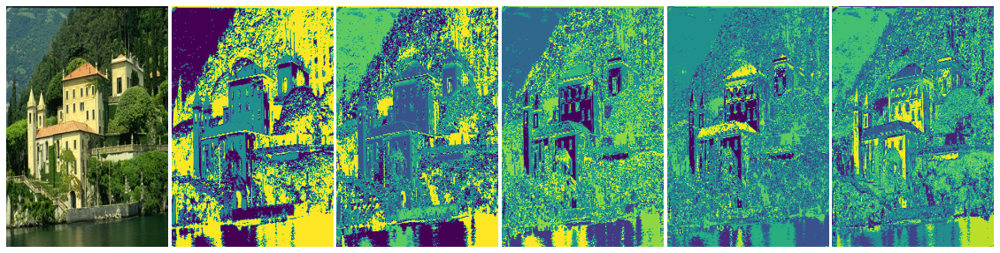


Data for image number: 49

 ** Average fmeasure for each K **
[0.37323844 0.40101999 0.33490219 0.26989538 0.23752756]
 ** Average entropy for each K **
[0.65474332 0.60093449 0.58360895 0.58071112 0.57792312]


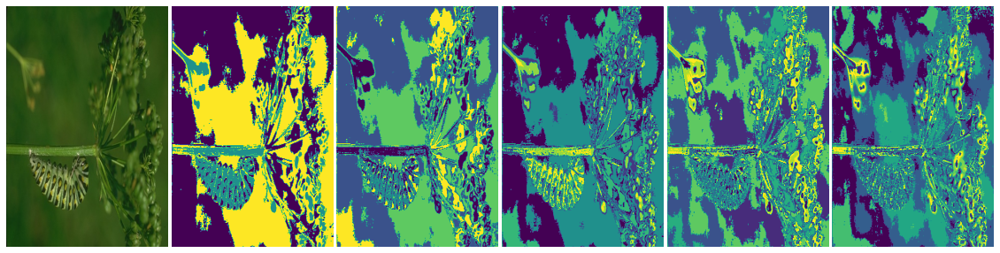


Data for image number: 50

 ** Average fmeasure for each K **
[0.57269677 0.59129778 0.52329189 0.44112971 0.40192553]
 ** Average entropy for each K **
[0.58255224 0.48599046 0.46464974 0.45777804 0.43219141]


In [ ]:
# F value for all imgs
for i in range(0,50):
  print("\nData for image number: " + str(i + 1))
  Segmentation(i)

In [ ]:
i = 0
for fmeasure in totalfmeasures:
  print("\n F-Measure for image number: " + str(i + 1))
  print(totalfmeasures[i])
  i += 1


 F-Measure for image number: 1
[0.39743042 0.42650851 0.35476563 0.33701404 0.31169113]

 F-Measure for image number: 2
[0.43759623 0.29943243 0.23453916 0.18978721 0.17317045]

 F-Measure for image number: 3
[0.44752755 0.37738674 0.28821848 0.33244867 0.29214755]

 F-Measure for image number: 4
[0.38302782 0.41500203 0.37139461 0.36003843 0.37750349]

 F-Measure for image number: 5
[0.44844588 0.50235324 0.41248935 0.34358205 0.30264141]

 F-Measure for image number: 6
[0.44810079 0.32029168 0.30508749 0.24584764 0.20517647]

 F-Measure for image number: 7
[0.62280295 0.46855098 0.37479813 0.31633128 0.27286453]

 F-Measure for image number: 8
[0.56534618 0.44985576 0.38811184 0.3481358  0.31604934]

 F-Measure for image number: 9
[0.58053144 0.45181179 0.41581414 0.35055876 0.31578881]

 F-Measure for image number: 10
[0.5656628  0.42145558 0.40131239 0.34061186 0.31137054]

 F-Measure for image number: 11
[0.42242624 0.37965301 0.406195   0.35196635 0.31852658]

 F-Measure for ima

In [ ]:
i = 0
for entropy in totalentropy:
  print("\n Entrop for image number: " + str(i + 1))
  print(totalentropy[i])
  i += 1


 Entrop for image number: 1
[0.775406   0.68451166 0.66704884 0.64619533 0.61885907]

 Entrop for image number: 2
[0.31842193 0.3137691  0.3118563  0.31152326 0.30157331]

 Entrop for image number: 3
[0.32544595 0.29889157 0.289776   0.27346478 0.27119429]

 Entrop for image number: 4
[1.0036932  0.95761637 0.91755875 0.8787018  0.84951898]

 Entrop for image number: 5
[0.58013681 0.52894443 0.51410637 0.50505803 0.4945683 ]

 Entrop for image number: 6
[0.28389314 0.27319778 0.2676441  0.26537277 0.26463079]

 Entrop for image number: 7
[0.39754502 0.37774503 0.37174804 0.36678579 0.36287293]

 Entrop for image number: 8
[0.61373949 0.52509251 0.49737462 0.4667331  0.44377795]

 Entrop for image number: 9
[0.6156127  0.59808749 0.57871366 0.57336019 0.56508816]

 Entrop for image number: 10
[0.44571534 0.38483216 0.34469096 0.34019554 0.32661054]

 Entrop for image number: 11
[0.63944975 0.613105   0.59726383 0.59212441 0.56738218]

 Entrop for image number: 12
[0.77153036 0.68868766




---



---



---

# GROUP TEAM
  - Mahmoud Elkarargy
  - Mariam Youssef
  - Raneem Ahmed


---



---



---

